In [1]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid
import seaborn as sns
from galaxy2galaxy import problems
import galflow as gf
import tensorflow as tf
from scipy import fftpack, fft
from scipy.ndimage import gaussian_filter, convolve
import pickle
from itertools import chain

tf.enable_eager_execution()

%matplotlib inline
np.seterr(divide='ignore', invalid='ignore')

tf.version.VERSION

'1.15.0'

In [2]:
import sys
path = '/home/astro/akhaury/GitHub/ADMM/'
sys.path.insert(1, path)

import plot_utils
from helper_func import *

data_path = '/home/astro/akhaury/Data/'

In [3]:
tf.executing_eagerly()

True

In [4]:
def ir2tf_simplifie(imp_resp, shape):
    
    dim = 2
    # Zero padding and fill
    irpadded = np.zeros(shape)
    irpadded[tuple([slice(0, s) for s in imp_resp.shape])] = imp_resp
    # Roll for zero convention of the fft to avoid the phase
    # problem. Work with odd and even size.
    for axis, axis_size in enumerate(imp_resp.shape):

        irpadded = np.roll(irpadded,
                           shift=-int(np.floor(axis_size / 2)),
                           axis=axis)

    return np.fft.rfftn(irpadded, axes=range(-dim, 0))
#     return fft.rfftn(irpadded, axes=range(-dim, 0))

def laplacian_simplifie(shape):
    
    impr = np.zeros([3,3])
    for dim in range(2):
        idx = tuple([slice(1, 2)] * dim +
                    [slice(None)] +
                    [slice(1, 2)] * (1 - dim))
        impr[idx] = np.array([-1.0,
                              0.0,
                              -1.0]).reshape([-1 if i == dim else 1
                                              for i in range(2)])
    impr[(slice(1, 2), ) * 2] = 4.0
    return ir2tf_simplifie(impr, shape), impr

def laplacian_tf(shape):
    return tf.convert_to_tensor(laplacian_simplifie(shape)[0])

def wiener_tf(image, psf, balance, laplacian=True):
    r"""Applies Wiener filter to image.

    This function takes an image in the direct space and its corresponding PSF in the
    Fourier space and performs a deconvolution using the Wiener Filter.

    Parameters
    ----------
    image   : 2D TensorFlow tensor
        Image in the direct space.
    psf     : 2D TensorFlow tensor
        PSF in the Fourier space (or K space).
    balance : scalar
        Weight applied to regularization.
    laplacian : boolean
        If true the Laplacian regularization is used else the identity regularization 
        is used.

    Returns
    -------
    tuple
        The first element is the filtered image in the Fourier space.
        The second element is the PSF in the Fourier space (also know as the Transfer
        Function).
    """
    trans_func = psf
    if laplacian:
        reg = laplacian_tf(image.shape)
        if psf.shape != reg.shape:
            trans_func = tf.signal.rfft2d(tf.signal.ifftshift(tf.cast(psf, 'float32')))
        else:
            trans_func = psf
    
    arg1 = tf.cast(tf.math.conj(trans_func), 'complex64')
    arg2 = tf.dtypes.cast(tf.math.abs(trans_func),'complex64') ** 2
    arg3 = balance
    if laplacian:
        arg3 *= tf.dtypes.cast(tf.math.abs(laplacian_tf(image.shape)), 'complex64')**2
    wiener_filter = arg1 / (arg2 + arg3)
    
    # Apply wiener in Foutier (or K) space
    wiener_applied = wiener_filter * tf.signal.rfft2d(tf.cast(image, 'float32'))
    
    return wiener_applied, trans_func

### Pre-processing Function

In [5]:
def pre_proc_unet(dico):
    r"""Preprocess the data and adds noise to generate the input galaxy images.

    This function takes the dictionnary of galaxy images and PSFs for the input and
    the target and returns a list containing 3 arrays: an array of noisy galaxy images, 
    an array of target galaxy images, and an array of PSFs

    Parameters
    ----------
    dico : dictionnary
        Array_like means all those objects -- lists, nested lists, etc. --
        that can be converted to an array.  We can also refer to
        variables like `var1`.

    Returns
    -------
    list
        list containing 3 arrays: an array of noisy galaxy images, 
        an array of target galaxy images, and an array of PSFs
    
    Example
    -------
    These are written in doctest format, and should illustrate how to
    use the function.

    >>> from galaxy2galaxy import problems # to list avaible problems run problems.available()
    >>> problem128 = problems.problem('attrs2img_cosmos_hst2euclide')
    >>> dset = problem128.dataset(Modes.TRAIN, data_dir='attrs2img_cosmos_hst2euclide')
    >>> dset = dset.map(pre_proc_unet)
    """
    # Add noise
    # For the estimation of CFHT noise standard deviation check section 3 of:
    # https://github.com/CosmoStat/ShapeDeconv/blob/master/data/CFHT/HST2CFHT.ipynb

#     sigma = tf.norm(dico['inputs']) / SNR
#     noise = tf.random_normal(shape=tf.shape(dico['inputs']), mean=0.0, stddev=sigma, dtype=tf.float32)
#     dico['inputs'] = dico['inputs'] + noise
    
    sigma_cfht = 23.59
    noise = tf.random_normal(shape=tf.shape(dico['inputs']), mean=0.0, stddev=sigma_cfht, dtype=tf.float32)
    dico['inputs'] = dico['inputs'] + noise
    
    # Normalize the UNet inputs to improve the training
    dico['targets'] /= 4000
    dico['inputs'] /= 4000

    # Second, we interpolate the image on a finer grid
    x_interpolant=tf.image.ResizeMethod.BICUBIC
    interp_factor = 2
    Nx = 64
    Ny = 64
    dico['inputs_cfht'] = tf.image.resize(dico['inputs'],
                    [Nx*interp_factor,
                    Ny*interp_factor],
                    method=x_interpolant)
    
    # Since we lower the resolution of the image, we also scale the flux
    # accordingly
    dico['inputs_cfht'] = dico['inputs_cfht'] / interp_factor**2

    balance = 9e-3  # determined using line search
    dico['inputs_tikho'], _ = wiener_tf(dico['inputs_cfht'][...,0], dico['psf_cfht'][...,0], balance)
    dico['inputs_tikho'] = tf.expand_dims(dico['inputs_tikho'], axis=0)
    psf_hst = tf.reshape(dico['psf_hst'], [dico['psf_hst'].shape[-1],*dico['psf_hst'].shape[:2]])
    psf_hst = tf.cast(psf_hst, 'complex64')
    # gf.kconvolve performs a convolution in the K (Fourier) space
    # inputs are given in K space
    # the output is in the direct space
    dico['inputs_tikho'] = gf.kconvolve(dico['inputs_tikho'], psf_hst,zero_padding_factor=1,interp_factor=interp_factor)[0,...]

    
    # Compute IRFFT of CFHT PSF
    dico['psf_cfht'] = tf.signal.ifftshift(tf.signal.irfft2d(tf.cast(tf.squeeze(dico['psf_cfht']), tf.complex64)))
    
    # Resize to 64 X 64 using area interpolation
    dico['psf_cfht'] = tf.squeeze(tf.image.resize(tf.expand_dims(dico['psf_cfht'], axis=-1), size=(64,64), method='area'))
    
    # Normalize the PSF
    dico['psf_cfht'] /= tf.math.reduce_sum(dico['psf_cfht'])
    
#     # Correct the miscentering error
#     shift = [-1,-1]
#     for key in ['inputs', 'inputs_tikho', 'targets', 'psf_cfht']:
#         dico[key] = tf.roll(dico[key], shift, axis=[0,1])
    
    return dico

### Loading Galaxy Images & PSF

In [6]:
with tf.compat.v1.Session() as sess:
    
    # Create an instance of the attrs2img_cosmos_parametric_cfht2hst problem
    Modes = tf.estimator.ModeKeys
    problem128 = problems.problem('attrs2img_cosmos_cfht2hst')
    dset = problem128.dataset(Modes.EVAL, data_dir=data_path+'attrs2img_cosmos_cfht2hst')
    dset = dset.repeat()
    dset = dset.map(pre_proc_unet)
    n_batch = 128
    dset = dset.batch(n_batch)

    # Build an iterator over the dataset
    iterator = dset.make_one_shot_iterator().get_next()

    # Initialize batch
    batch = sess.run(iterator)

    
for key in ['inputs', 'psf_hst', 'targets', 'psf_cfht', 'inputs_cfht', 'inputs_tikho']:
    batch[key] = np.squeeze(batch[key])


INFO:tensorflow:Reading data files from /home/astro/akhaury/Data/attrs2img_cosmos_cfht2hst/attrs2img_cosmos_cfht2hst-dev*
INFO:tensorflow:partition: 0 num_data_files: 2

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.




In [7]:
# dirac = np.zeros((64,64))
# dirac[64//2, 64//2] = 1.0
# gauss_kern = gaussian_filter(dirac, 0.5)
# plt.imshow(gauss_kern[30:35, 30:35]); plt.colorbar(); plt.show()
# print(np.sum(gauss_kern))

In [8]:
# for i in range(128):
    
#     batch['targets_mcs'][i] = convolve(batch['targets'][i], gauss_kern, mode='constant', cval=0.0)
#     batch['psf_mcs'][i] = np.squeeze(fftpack.fftshift(fftpack.ifftn(fftpack.ifftshift(fftpack.fftshift(fftpack.fftn(batch['psf_cfht'][i]))/fftpack.fftshift(fftpack.fftn(gauss_kern))))))

### Load Tikhonet Model

In [9]:
model_tikho = tf.keras.models.load_model(data_path+'optical_tikhonet_None-constraint_scales-4_steps-625_epochs-10_growth_rate-12_batch_size-128_activationfunction-relu', compile=False)

# Deconvolution

In [10]:
res_tikho = tf.squeeze(model_tikho(tf.expand_dims(batch['inputs_tikho'], -1)))

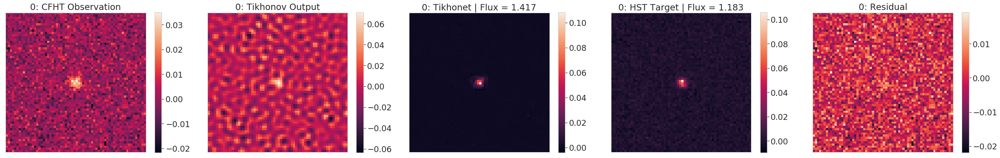

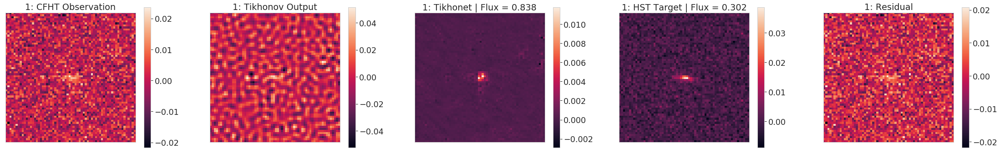

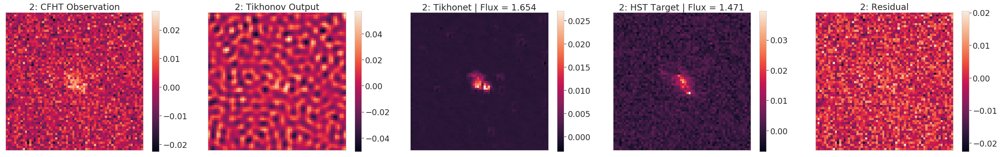

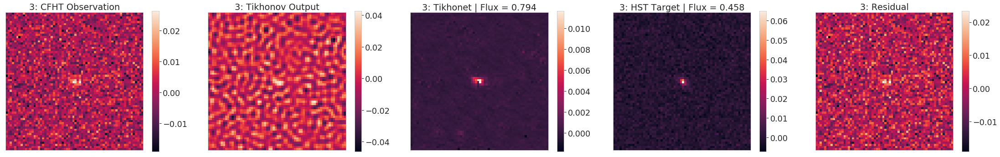

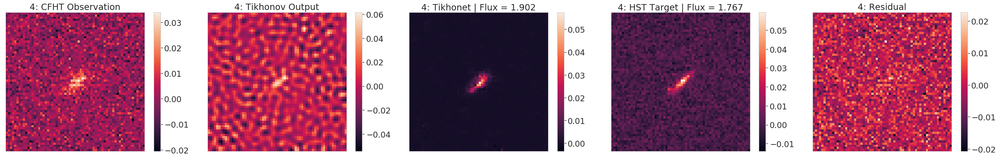

...

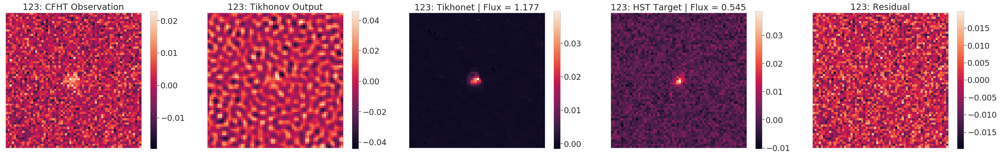

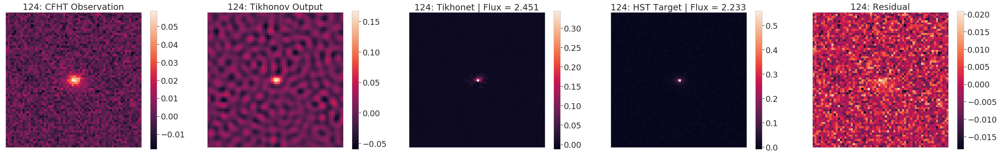

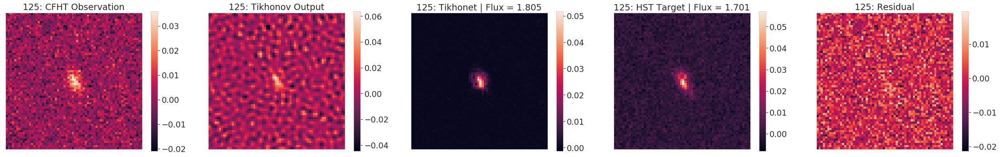

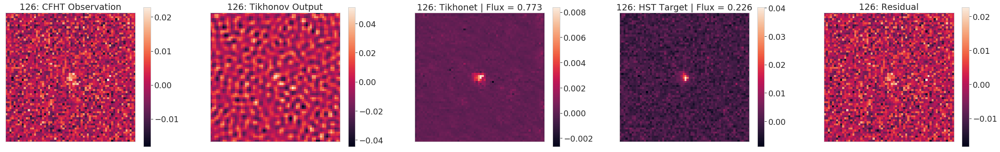

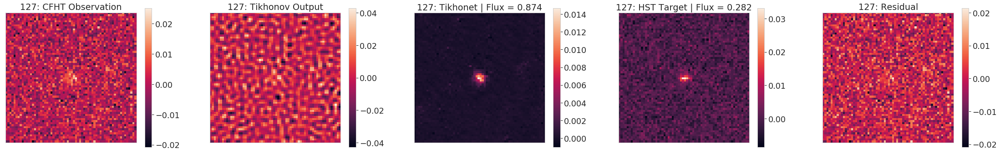

In [11]:
# set seaborn theme and style
sns.set_theme()
sns.set_context("paper", font_scale=2, rc={"lines.linewidth": 2.5})

#remove grid from images
sns.set_style("whitegrid", {'axes.grid' : False})

for i in range(n_batch):
    plt.figure(figsize=(31,5))
    plt.subplot(151)
    plt.imshow(batch['inputs'][i]); plt.title('{}: CFHT Observation'.format(i))
    plt.colorbar(); plt.xticks([]); plt.yticks([])
    plt.subplot(152)
    plt.imshow(batch['inputs_tikho'][i]); plt.title('{}: Tikhonov Output'.format(i))
    plt.colorbar(); plt.xticks([]); plt.yticks([])
    plt.subplot(153)
    im_rec = res_tikho[i]; flux_rec = np.round(np.sum(im_rec), 3)
#     flux_rec = np.round(np.sum((im_rec > 3*(sigma_mad(im_rec)))*im_rec), 3)
    plt.imshow(im_rec); plt.title('{}: Tikhonet | Flux = {:0.3f}'.format(i, flux_rec))
    plt.colorbar(); plt.xticks([]); plt.yticks([])
    plt.subplot(154)
    im_tar = batch['targets'][i]; flux_tar = np.round(np.sum(im_tar), 3)
#     flux_tar = np.round(np.sum((im_tar > 3*(sigma_mad(im_tar)))*im_tar), 3)
    plt.imshow(im_tar); plt.title('{}: HST Target | Flux = {:0.3f}'.format(i, flux_tar))
    plt.colorbar(); plt.xticks([]); plt.yticks([])
    plt.subplot(155)
    plt.imshow(batch['inputs'][i] - convolve(batch['psf_cfht'][i], res_tikho[i])); plt.title('{}: Residual'.format(i))
    plt.colorbar(); plt.xticks([]); plt.yticks([])
    plt.tight_layout()
    plt.show()

In [12]:
# gal_rng = range(0, n_batch, 20)
# n_gal_deconv = len(gal_rng)

# list_im = []
# for i in gal_rng:
#     list_im += [batch['inputs'][i]]
#     list_im += [res_tikho[i]]
#     list_im += [res_shapenet[i]]
#     list_im += [batch['targets'][i]]

# list_min = []
# list_max = []

# for im in batch['targets']:
#     list_min += [np.min(im)]
#     list_max += [np.max(im)]
    
# # list_min = np.repeat(np.array(list_min), 4).T
# # list_max = np.repeat(np.array(list_max), 4).T

# list_min = np.array(list_min).T
# list_max = np.array(list_max).T

# fig = plt.figure(figsize=(35, 35))
# grid = ImageGrid(fig, 111,  # similar to subplot(111)
#                  nrows_ncols=(n_gal_deconv, 4),  # creates 2x2 grid of axes
#                  axes_pad=0.1,    # pad between axes in inch.
# #                  cbar_location="right",
#                  cbar_mode="edge") 

# i=0
# for ax, cax, im in zip(grid, grid.cbar_axes, list_im):
#     # Iterating over the grid returns the Axes.
#     imx = ax.imshow(im, vmin=list_min[i], vmax=list_max[i]); #ax.axes.xaxis.set_visible(False); ax.axes.yaxis.set_visible(False);
#     cb = cax.colorbar(imx); cb.ax.tick_params(labelsize=10)
#     i+=1
    
# labels = ['Observation', 'Tikhonet', 'ShapeNet', 'Ground Truth']
# for ax, label in zip(grid,labels):
#     ax.set_title(label)

# #plt.savefig('cfht2hst_images_unflagged.pdf', bbox_inches='tight')